In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/mobile-class-dnn/keras/default/1/DNNModelTuned/saved_model.pb
/kaggle/input/mobile-class-dnn/keras/default/1/DNNModelTuned/keras_metadata.pb
/kaggle/input/mobile-class-dnn/keras/default/1/DNNModelTuned/variables/variables.index
/kaggle/input/mobile-class-dnn/keras/default/1/DNNModelTuned/variables/variables.data-00000-of-00001
/kaggle/input/mobile-price-classification/train.csv
/kaggle/input/mobile-price-classification/test.csv


# Mobile Price Range Classification Using DNN (Deep Neural Network)

**Data used** : [Mobile Price Range Classification](https://www.kaggle.com/datasets/iabhishekofficial/mobile-price-classification)

**Problem** : How to estimate price range based of Features of the Phone

**Side Question** : What feature that impacted price range estimation the most

**Author** : Muhammad Farid Rahman | [LinkedIn](https://www.linkedin.com/in/muhammad-farid-952795217/) | [GitHub](https://github.com/SoF4rAway)   

## Notebook Prep

Import all used libraries here, its best practice to import all in one cell for better readability

In [2]:
import os
import sys
import zipfile

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, models, optimizers
from tensorflow.keras import mixed_precision
from tensorflow.keras import backend as K

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import  tqdm

from sklearn.model_selection import train_test_split
from sklearn.metrics import recall_score, f1_score, confusion_matrix
from sklearn.preprocessing import LabelEncoder

import keras_tuner as kt
from keras_tuner import HyperModel
from keras_tuner import RandomSearch

mixed_precision.set_global_policy('float32')

gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
  tf.config.experimental.set_memory_growth(gpu, True)

### Dataset Loading

Dataset loaded using pandas `read_csv()` method as the file is a CSV (Comma Separated Values) refer to [Pandas Documentation](https://pandas.pydata.org/docs/reference/frame.html) for detailed usage.

In [3]:
if os.path.isfile(os.path.join('/kaggle/input/mobile-price-classification/train.csv')):
    df = pd.read_csv(os.path.join('/kaggle/input/mobile-price-classification/train.csv'),usecols=[col for col in pd.read_csv(os.path.join('/kaggle/input/mobile-price-classification/train.csv')).columns if col != "Id"])
else:
    print("Not Found")

def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn
warnings.filterwarnings('ignore')

## Exploratory Data Analysis

First we conduct a descriptive data analysis so we can get hold on the basics of the dataset, typically we need to know what data types are each column, is there any null value, or is there any non numeric value. To do initial data screening we use `info()`, `describe()`, and typically `head()` or `tail()` method of the Pandas DataFrame object

In [4]:
df.describe()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
count,2000.000000,2000.0000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,...,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,1238.518500,0.4950,1.522250,0.509500,4.309500,0.521500,32.046500,0.501750,140.249000,4.520500,...,645.108000,1251.515500,2124.213000,12.306500,5.767000,11.011000,0.761500,0.503000,0.507000,1.500000
std,439.418206,0.5001,0.816004,0.500035,4.341444,0.499662,18.145715,0.288416,35.399655,2.287837,...,443.780811,432.199447,1084.732044,4.213245,4.356398,5.463955,0.426273,0.500116,0.500076,1.118314
min,501.000000,0.0000,0.500000,0.000000,0.000000,0.000000,2.000000,0.100000,80.000000,1.000000,...,0.000000,500.000000,256.000000,5.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000
25%,851.750000,0.0000,0.700000,0.000000,1.000000,0.000000,16.000000,0.200000,109.000000,3.000000,...,282.750000,874.750000,1207.500000,9.000000,2.000000,6.000000,1.000000,0.000000,0.000000,0.750000
50%,1226.000000,0.0000,1.500000,1.000000,3.000000,1.000000,32.000000,0.500000,141.000000,4.000000,...,564.000000,1247.000000,2146.500000,12.000000,5.000000,11.000000,1.000000,1.000000,1.000000,1.500000
75%,1615.250000,1.0000,2.200000,1.000000,7.000000,1.000000,48.000000,0.800000,170.000000,7.000000,...,947.250000,1633.000000,3064.500000,16.000000,9.000000,16.000000,1.000000,1.000000,1.000000,2.250000
max,1998.000000,1.0000,3.000000,1.000000,19.000000,1.000000,64.000000,1.000000,200.000000,8.000000,...,1960.000000,1998.000000,3998.000000,19.000000,18.000000,20.000000,1.000000,1.000000,1.000000,3.000000


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   battery_power  2000 non-null   int64  
 1   blue           2000 non-null   int64  
 2   clock_speed    2000 non-null   float64
 3   dual_sim       2000 non-null   int64  
 4   fc             2000 non-null   int64  
 5   four_g         2000 non-null   int64  
 6   int_memory     2000 non-null   int64  
 7   m_dep          2000 non-null   float64
 8   mobile_wt      2000 non-null   int64  
 9   n_cores        2000 non-null   int64  
 10  pc             2000 non-null   int64  
 11  px_height      2000 non-null   int64  
 12  px_width       2000 non-null   int64  
 13  ram            2000 non-null   int64  
 14  sc_h           2000 non-null   int64  
 15  sc_w           2000 non-null   int64  
 16  talk_time      2000 non-null   int64  
 17  three_g        2000 non-null   int64  
 18  touch_sc

In [ ]:
df.head(10)

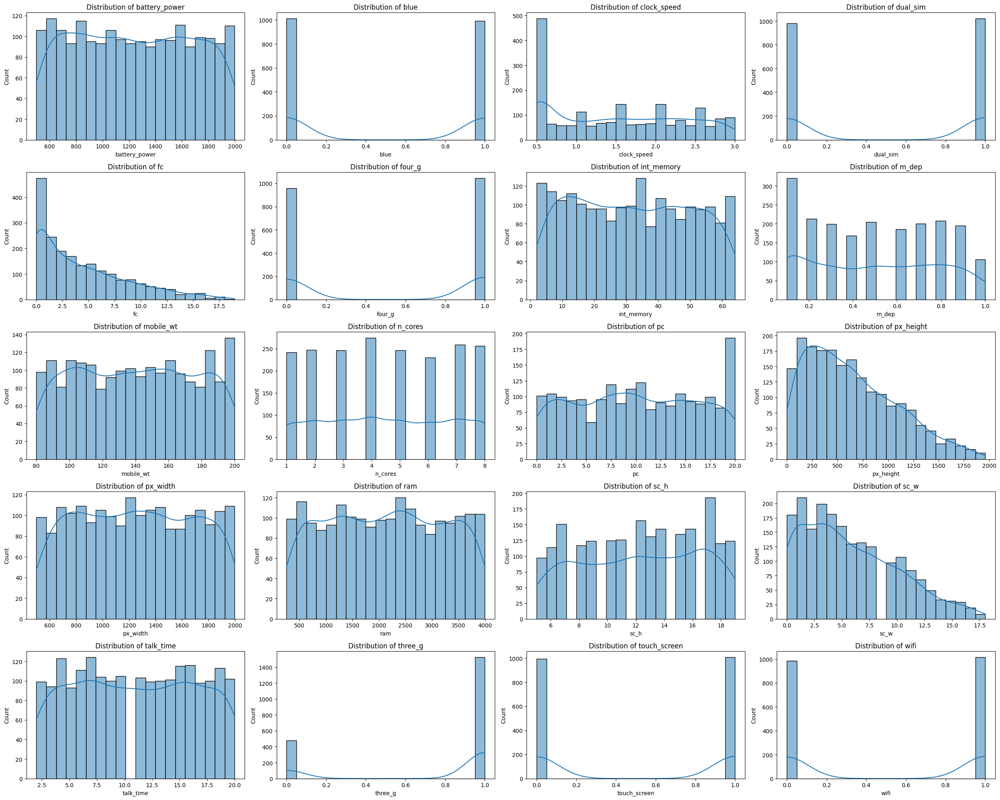

In [6]:
# Number of columns (features) to plot
num_cols = len(df.columns) - 1

# Create a grid of subplots
fig, axes = plt.subplots(5, 4, figsize=(25, 20))
axes = axes.flatten()

# Plot each feature
for i, col in enumerate(df.columns[:-1]):
    sns.histplot(ax=axes[i], data=df, x=col, bins=20, kde=True)
    axes[i].set_title(f"Distribution of {col}")

# Adjust the layout
plt.tight_layout()
plt.show()


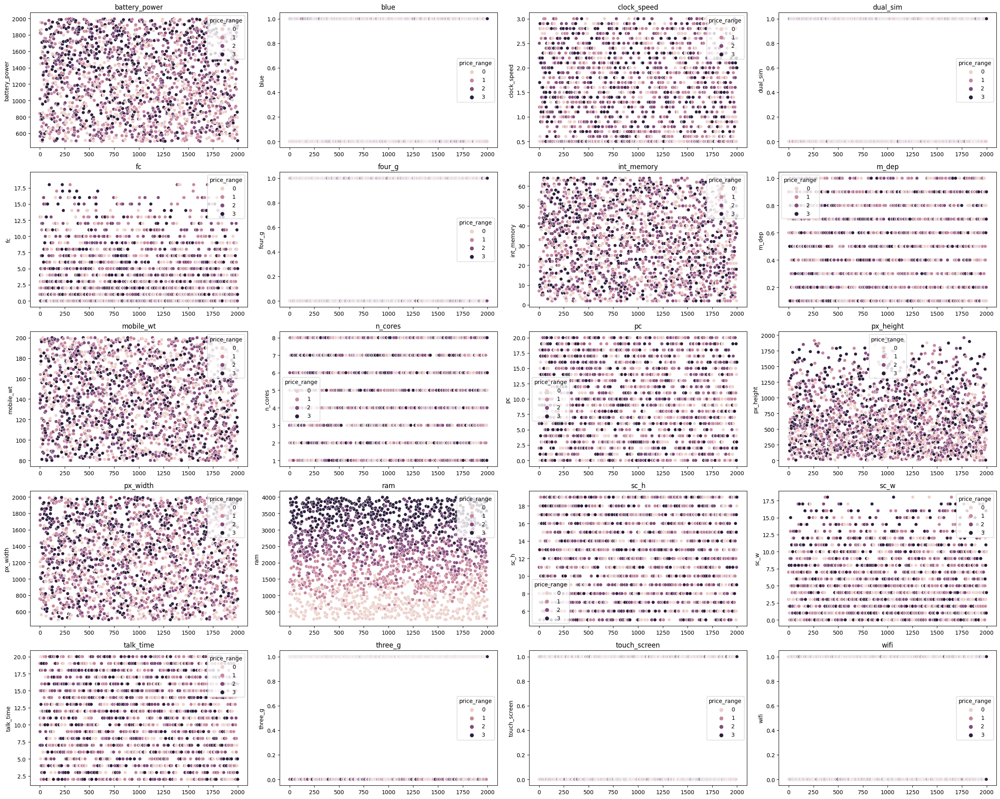

In [7]:
# Number of columns (features) to plot
num_cols = len(df.columns) - 1

# Create a grid of subplots
fig, axes = plt.subplots(5, 4, figsize=(25, 20))
axes = axes.flatten()

# Plot each feature
for i, col in enumerate(df.columns[:-1]):
    sns.scatterplot(ax=axes[i], data=df, x=df.index, y=col, hue="price_range")
    axes[i].set_title(col)

# Adjust the layout
plt.tight_layout()
plt.show()


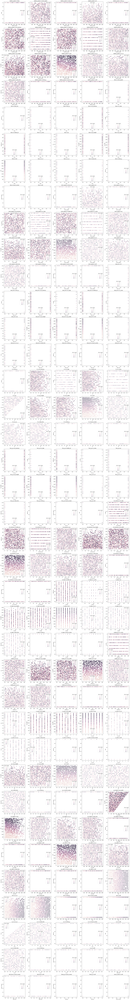

In [8]:
# List of columns to plot
columns = df.columns[:-1]
num_cols = len(columns)

# Calculate the number of plots needed
num_plots = num_cols * (num_cols - 1) // 2

# Create a grid of subplots with a maximum of 5 plots per row
fig, axes = plt.subplots((num_plots // 5) + 1, 5, figsize=(25, (num_plots // 5 + 1) * 5))
axes = axes.flatten()

plot_num = 0

# Plot each pair of features without repetition
for i in range(num_cols):
    for j in range(i + 1, num_cols):
        sns.scatterplot(ax=axes[plot_num], data=df, x=columns[i], y=columns[j], hue='price_range')
        axes[plot_num].set_title(f'{columns[i]} vs {columns[j]}')
        plot_num += 1

# Hide any unused subplots
for k in range(plot_num, len(axes)):
    fig.delaxes(axes[k])

# Adjust the layout
plt.tight_layout()
plt.show()


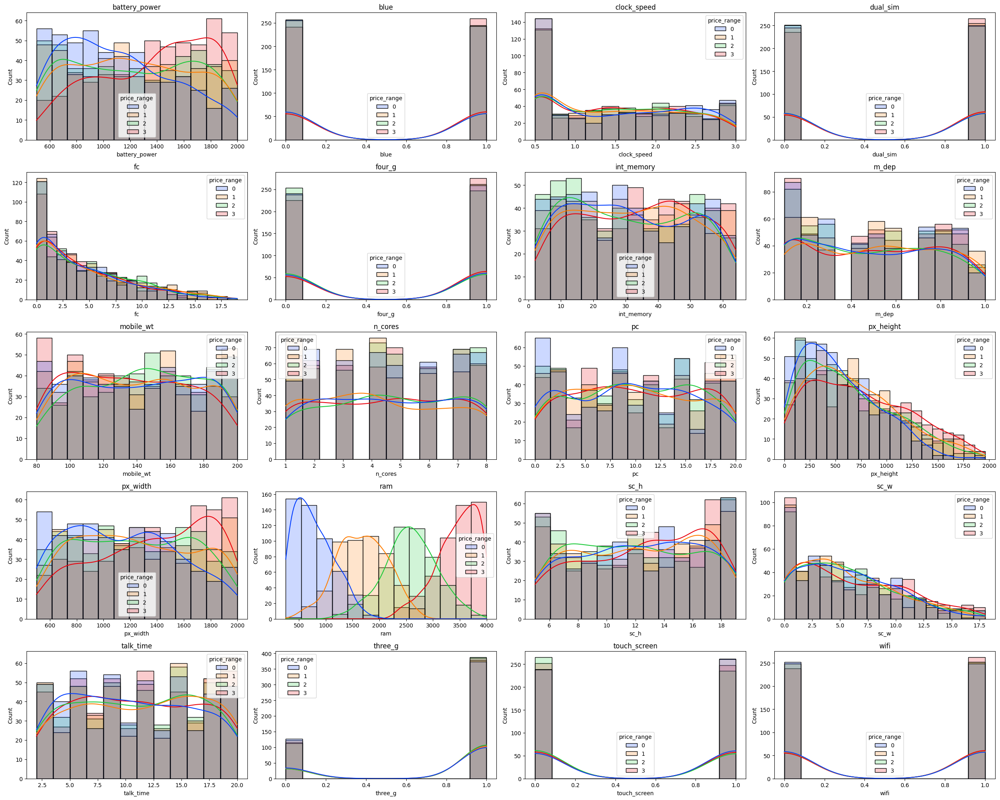

In [9]:
import seaborn as sns
import matplotlib.pyplot as plt

# List of columns to plot
columns = df.columns[:-1]
num_cols = len(columns)

# Create a grid of subplots
fig, axes = plt.subplots(5, 4, figsize=(25, 20))
axes = axes.flatten()

# Set the color palette
palette = sns.color_palette("bright")

# Plot each feature with histplot, transparency, and KDE in subplots
for i, col in enumerate(columns):
    sns.histplot(ax=axes[i], data=df, x=col, hue="price_range", kde=True, alpha=0.2, palette=palette)
    axes[i].set_title(col)

# Adjust the layout
plt.tight_layout()
plt.show()


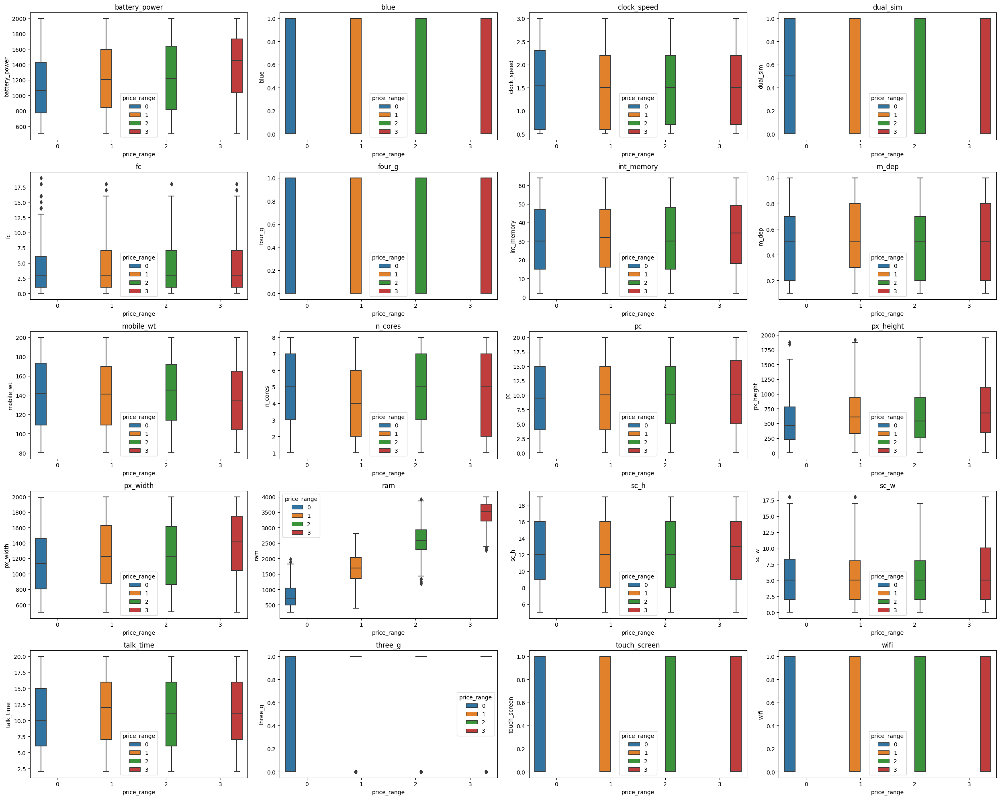

In [10]:
import seaborn as sns
import matplotlib.pyplot as plt

# List of columns to plot
columns = df.columns[:-1]
num_cols = len(columns)

# Create a grid of subplots
fig, axes = plt.subplots(5, 4, figsize=(25, 20))
axes = axes.flatten()

# Plot each feature with boxplot in subplots
for i, col in enumerate(columns):
    sns.boxplot(ax=axes[i], data=df, x='price_range', y=col, hue="price_range")
    axes[i].set_title(col)

# Adjust the layout
plt.tight_layout()
plt.show()


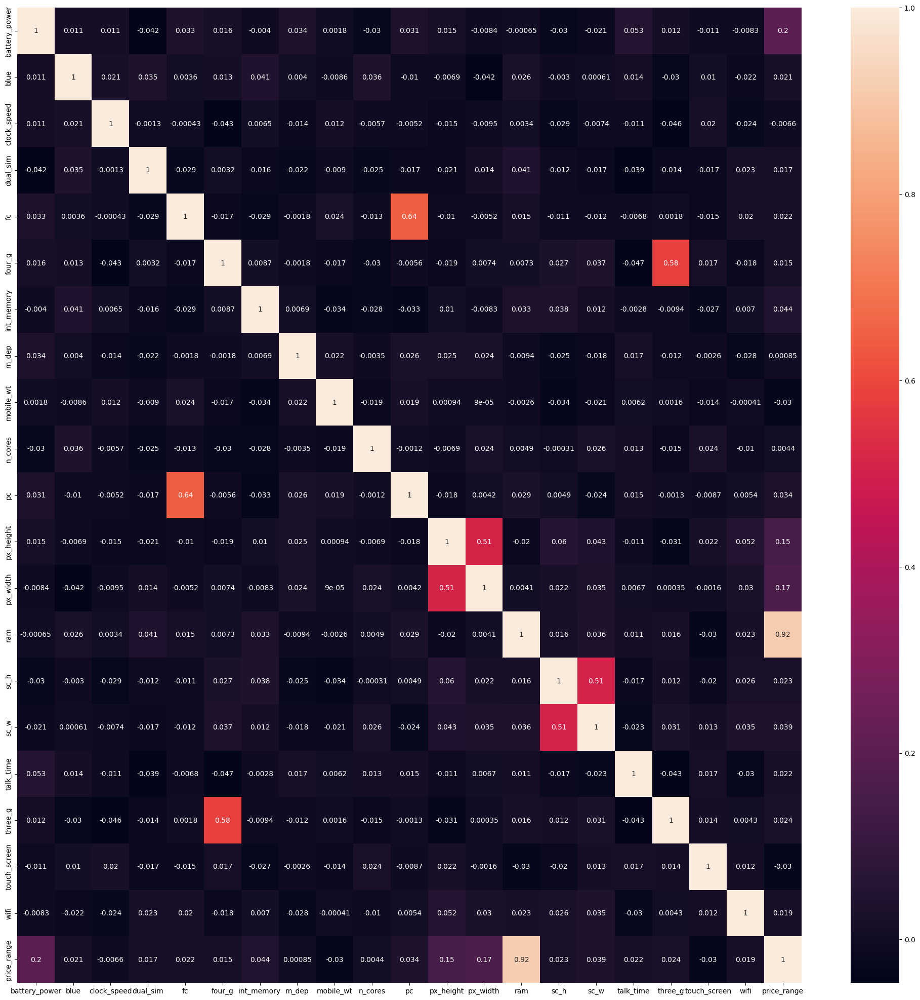

In [11]:
corr = df.corr()
plt.figure(figsize=(25, 25))
sns.heatmap(corr, annot=True)
plt.show()

In [12]:
# Selected features
selected_features = ['ram', 'battery_power', 'px_height', 'px_width', 'int_memory', 'sc_w']

# Create a new DataFrame with the selected features and the target column
X = df[selected_features + ['price_range']]

# Display the new DataFrame
X.head()


,ram,battery_power,px_height,px_width,int_memory,sc_w,price_range
0,2549,842,20,756,7,7,1
1,2631,1021,905,1988,53,3,2
2,2603,563,1263,1716,41,2,2
3,2769,615,1216,1786,10,8,2
4,1411,1821,1208,1212,44,2,1


In [13]:
y = X.pop("price_range")

In [14]:
y.head()

0    1
1    2
2    2
3    2
4    1
Name: price_range, dtype: int64

In [15]:
X.head()

,ram,battery_power,px_height,px_width,int_memory,sc_w
0,2549,842,20,756,7,7
1,2631,1021,905,1988,53,3
2,2603,563,1263,1716,41,2
3,2769,615,1216,1786,10,8
4,1411,1821,1208,1212,44,2


In [16]:
X_train, val_subset_x, y_train, val_subset_y =train_test_split(X, y, test_size=0.2, random_state=1)
X_test, X_val, y_test, y_val =train_test_split(val_subset_x, val_subset_y, test_size=0.5, random_state=1)

In [17]:
X_train.shape

(1600, 6)

In [18]:
y_train.shape

(1600,)

In [19]:
def plot_loss_and_accuracy(history):
    plt.figure(figsize=(12, 5))

    # Plotting Loss
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)
    plt.title('Loss Over Epochs')

    # Plotting Accuracy
    plt.subplot(1, 2, 2)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid(True)
    plt.title('Accuracy Over Epochs')

    plt.tight_layout()
    plt.show()


In [20]:
model = keras.Sequential([
    layers.Input(shape=X_train.shape[1:]),
    layers.Dense(928, activation="relu"),
    layers.Dense(352, activation="relu"),
    layers.Dense(672, activation="relu"),
    layers.Dense(928, activation="relu"),
    layers.Dense(448, activation="relu"),
    layers.Dense(864, activation="relu"),
    layers.Dense(608, activation="relu"),
    layers.Dense(416, activation="relu"),
    layers.Dropout(rate=0.5),
    layers.Dense(4, activation="softmax"),
])
from tensorflow.keras.optimizers import Adam

# Apply gradient clipping
optimizer = Adam(learning_rate=2.9873e-3)
model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 928)                 │           6,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 352)                 │         327,008 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 672)                 │         237,216 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 928)                 │         624,544 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 448)                 │         416,192 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 864)                 │         387,936 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 608)                 │         525,920 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 416)                 │         253,344 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 416)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 4)                   │           1,668 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 2,780,324 (10.61 MB)

 Trainable params: 2,780,324 (10.61 MB)

 Non-trainable params: 0 (0.00 B)

In [21]:
stop = tf.keras.callbacks.EarlyStopping(
    monitor='val_accuracy',
    patience=10,
    min_delta=0.01,
    mode='max',
    restore_best_weights=True)

# Define the step learning rate scheduler function
def step_decay(epoch, lr):
    drop = 0.75
    epochs_drop = 15
    if epoch % epochs_drop == 0 and epoch:
        return lr * drop
    return lr

# Create the LearningRateScheduler callback
scheduler = tf.keras.callbacks.LearningRateScheduler(step_decay)

In [22]:
history = model.fit(X_train, y_train, epochs=100, validation_data=(X_val, y_val), callbacks=[scheduler])

Epoch 1/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 4s 27ms/step - accuracy: 0.3436 - loss: 38.7984 - val_accuracy: 0.5250 - val_loss: 1.0252 - learning_rate: 0.0030
Epoch 2/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.4778 - loss: 1.0721 - val_accuracy: 0.4950 - val_loss: 1.0991 - learning_rate: 0.0030
Epoch 3/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.5218 - loss: 0.9833 - val_accuracy: 0.5150 - val_loss: 0.9770 - learning_rate: 0.0030
Epoch 4/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.5726 - loss: 0.8946 - val_accuracy: 0.6400 - val_loss: 0.8125 - learning_rate: 0.0030
Epoch 5/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.6532 - loss: 0.7891 - val_accuracy: 0.6850 - val_loss: 0.6783 - learning_rate: 0.0030
Epoch 6/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.6932 - loss: 0.6902 - val_accuracy: 0.6300 - val_loss: 0.8061 - learning_rate: 0.0030
Epoch 7/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6312 - loss: 0.7893 -

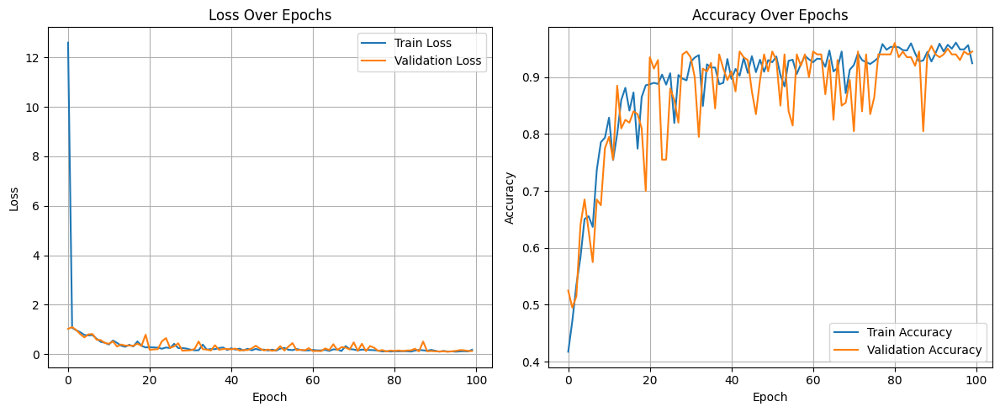

In [23]:
plot_loss_and_accuracy(history)

In [24]:
yhat = model.predict(X_test)
yhat.shape

7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


(200, 4)

In [25]:
yhat[:10]

array([[4.4968977e-04, 9.9937600e-01, 1.7428013e-04, 4.7147036e-10],
       [1.3265844e-11, 1.0868291e-08, 2.3547513e-02, 9.7645253e-01],
       [1.2922778e-18, 2.2416337e-14, 1.3056051e-04, 9.9986959e-01],
       [1.5390274e-10, 9.8507478e-08, 7.6050669e-02, 9.2394918e-01],
       [5.3481099e-16, 2.5783614e-12, 6.4698409e-04, 9.9935299e-01],
       [2.2006470e-06, 1.5411251e-03, 9.9601877e-01, 2.4379189e-03],
       [2.2024761e-03, 9.9769199e-01, 1.0563213e-04, 1.0288863e-09],
       [9.4855736e-16, 4.0492050e-12, 7.5352052e-04, 9.9924648e-01],
       [8.1073104e-06, 6.5499870e-03, 9.9286109e-01, 5.8078807e-04],
       [1.5451651e-08, 8.2292063e-06, 6.1893117e-01, 3.8106051e-01]],
      dtype=float32)

In [26]:
y_test[:10]

299     1
87      3
1381    3
834     3
1512    3
558     2
874     1
764     3
241     2
1678    2
Name: price_range, dtype: int64

In [27]:
import numpy as np

# Convert predicted probabilities to class labels
yhat_labels = np.argmax(yhat, axis=1)

# Use the true integer labels directly
y_test_labels = y_test if y_test.ndim == 1 else np.argmax(y_test, axis=1)

# Display the first few converted labels
print(f"Predicted labels: {yhat_labels[:10]}")
print(f"True labels: {y_test_labels[:10]}")


Predicted labels: [1 3 3 3 3 2 1 3 2 2]
True labels: 299     1
87      3
1381    3
834     3
1512    3
558     2
874     1
764     3
241     2
1678    2
Name: price_range, dtype: int64


Recall: 0.935
F1 Score: 0.9349699605788331


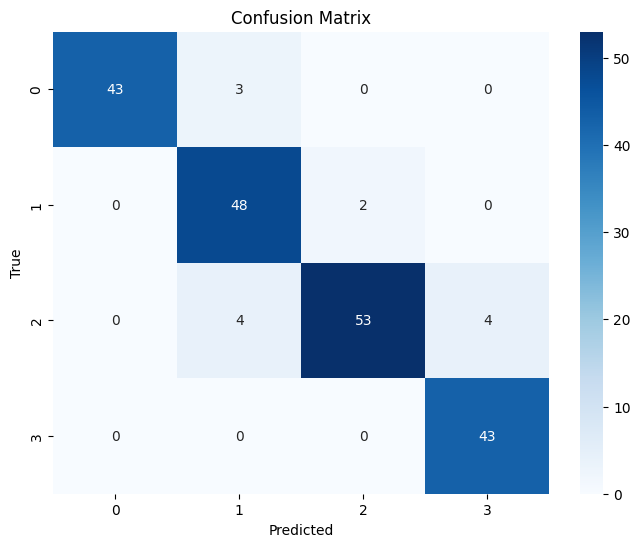

In [28]:
# Calculate Recall
recall = recall_score(y_test_labels, yhat_labels, average='weighted')
print(f"Recall: {recall}")

# Calculate F1 Score
f1 = f1_score(y_test_labels, yhat_labels, average='weighted')
print(f"F1 Score: {f1}")

# Calculate the confusion matrix
cm = confusion_matrix(y_test_labels, yhat_labels)

# Get the unique labels
labels = df['price_range'].unique()

# Ensure labels are sorted and converted to strings
labels = [str(int(label)) for label in sorted(labels)]

# Create a heatmap to visualize the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=labels, yticklabels=labels)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()
